In [1]:
import os
import glob
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
%matplotlib inline

In [2]:
DDIR = '/Users/jasperdejong/Documents/PhD/Geo/data/cesm1_0_4/'
data = {
    'mres':{
        'cnt': ['mres.rcp85.cam.h0gm.200001-209912.nc', {'c':'k'}],
        'sai': ['mres.sai2050.cam.h0gm.204501-209712.nc', {'c':'b', 'ls':'-.'}],
    }, 
    'hres':{
        'spin': ['hres.spinup.cam.h0gm.209101-209111.nc', {'c':'orange', 'marker':'>'}],
        'sai1': ['hres.sai2050.cam.h0gm.209111-209211.001.nc', {'c':'r', 'marker':'x'}],
        'sai2': ['hres.sai2050.cam.h0gm.209111-209211.002.nc', {'c':'r', 'marker':'x'}],
    }
}
for res in data:
    for exp in data[res]:
        data[res][exp][0] = xr.open_dataset(DDIR+data[res][exp][0])

data['hres']['spin'][0] = xr.concat((data['hres']['spin'][0], data['hres']['sai1'][0].isel(time=0)), 'time')

In [3]:
ODIR = '/Users/jasperdejong/Documents/PhD/Meetings/240828tseries/'

In [4]:
def plot(ax, VAR, legendax=None):
    for res in data:
        for exp in data[res]:
            try:
                xrVAR, plot_kwargs = data[res][exp][0][VAR], data[res][exp][1]
                #ax.set_ylabel(getattr(xrVAR, 'units', None))
            except KeyError:
                print("skipping",res,exp,VAR,"due to KeyError")
                continue
            dims = xrVAR.dims
            if 'lev' in dims:
                xrVAR = xrVAR.mean('lev', keep_attrs=True)
            if 'ilev' in dims:
                xrVAR = xrVAR.mean('ilev', keep_attrs=True)
            if xrVAR.dtype in ['S8', 'O']:
                print("skipping",res,exp,VAR,"due to dtype",xrVAR.dtype)
                continue
            if not hasattr(xrVAR, 'time'):
                print("drawing horizontal line for",res,exp,VAR)
                ax.axhline(xrVAR, label=f"{res}.{exp}", **plot_kwargs)
                continue
            VARym = xrVAR if exp=='cnt' else xrVAR.coarsen(time=12).mean('time')
            if VARym.time.size == 1:
                VARym.plot.scatter(ax=ax, label=f"{res}.{exp}", **plot_kwargs)
            else:
                VARym.plot(ax=ax, label=f"{res}.{exp}", **plot_kwargs)
    if legendax:
        h, l = ax.get_legend_handles_labels()
        legendax.legend(h, l)
    ax.set_title(f"{VAR} {dims}")
    ax.grid()


def plot3d(axs, VAR, legendax=None):
    for res in data:
        for exp in data[res]:
            try:
                VAR_i, plot_kwargs = data[res][exp][0][VAR], data[res][exp][1]
                #ax.set_ylabel(getattr(xrVAR, 'units', None))
            except KeyError:
                print("skipping",res,exp,VAR,"due to KeyError")
                continue
            vdim = 'lev' if 'lev' in VAR_i.dims else 'ilev'
            if 'time' in VAR_i.dims:
                if res == 'mres' and exp == 'cnt':
                    VAR_if = VAR_i.sel(time=slice('2090','2100'))
                    VAR_if = VAR_if.mean('time', keep_attrs=True)
                    VAR_if.plot(ax=axs[0],y=vdim, label=f"{res}.{exp}-F", **plot_kwargs)
                    VAR_ii = VAR_i.sel(time=slice('2000','2010'))
                    VAR_ii = VAR_ii.mean('time', keep_attrs=True)
                    VAR_ii.plot(ax=axs[0],y=vdim, label=f"{res}.{exp}-I", ls='--', **plot_kwargs)
                elif res == 'mres' and exp == 'sai':
                    VAR_if = VAR_i.sel(time=slice('2090','2100'))
                    VAR_if = VAR_if.mean('time', keep_attrs=True)
                    VAR_if.plot(ax=axs[0],y=vdim, label=f"{res}.{exp}-F", **plot_kwargs)
                else:   
                    VAR_i = VAR_i.mean('time', keep_attrs=True)
                    VAR_i.plot(ax=axs[0],y=vdim, label=f"{res}.{exp}", **plot_kwargs)
            axs[0].invert_yaxis()
            axs[0].set_xlabel(f"{getattr(VAR_i, 'long_name', None)+' '}[{getattr(VAR_i, 'units', None)}]")
            axs[0].set_title(f"{VAR}")
            axs[0].grid()
    if legendax:
        h, l = axs[0].get_legend_handles_labels()
        legendax.legend(h, l)
        
    c = 1
    for res in data:
        for exp in data[res]:
            axs[c].set_title(f"{res}.{exp}")
            axs[c].set_ylabel("")
            try:
                xrVAR = data[res][exp][0][VAR]
            except KeyError:
                c+=1
                continue
            vdim = 'lev' if 'lev' in xrVAR.dims else 'ilev'
            if 'time' not in xrVAR.dims:
                c+=1
                continue
            p = (xrVAR-xrVAR.mean('time')).plot.pcolormesh(ax=axs[c], y=vdim, rasterized=True)
            axs[c].set_title(f"{res}.{exp}")
            axs[c].set_ylabel("")
            p.colorbar.ax.set_ylabel(r"$\Delta$"+p.colorbar.ax.get_ylabel())
            axs[c].grid()
            c += 1
    axs[0].invert_yaxis()

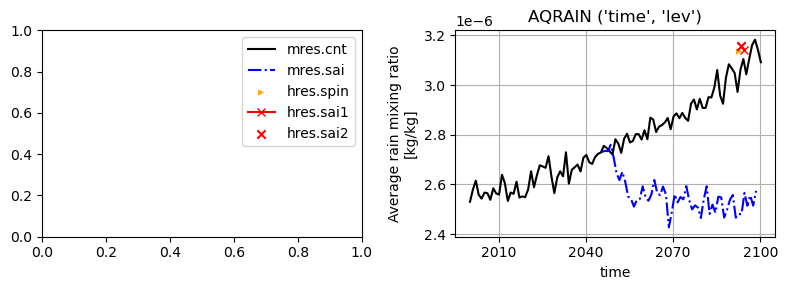

In [5]:
fig, ax = plt.subplots(1,2, figsize=(8,3))
plot(ax[1], 'AQRAIN', ax[0])
fig.tight_layout()

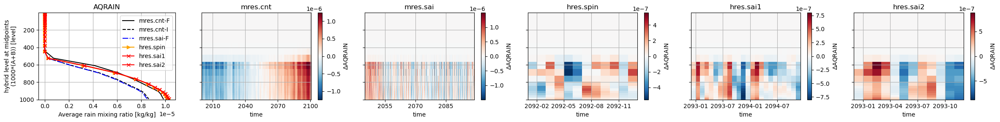

In [6]:
# test 3D plotting
fig, ax = plt.subplots(1,6, figsize=(24,3), sharey=True)
plot3d(ax, 'AQRAIN', ax[0])
fig.tight_layout()

In [7]:
allvars = set()
allvars3d = set()
for res in data:
    for exp in data[res]:
        allvars |= set(data[res][exp][0].data_vars)
ds = data['hres']['spin'][0] # happens to contain all variables
for v in allvars:
    if 'lev' in ds[v].dims or 'ilev' in ds[v].dims:
        allvars3d.add(v)
allvars = sorted(allvars) # creates a list
allvars3d = sorted(allvars3d)
print(f"There are {len(allvars)} data variables, of which {len(allvars3d)} depend on height.")

There are 249 data variables, of which 94 depend on height.


In [8]:
print("List of constant variables:\n"+80*"=")
const_vars = set()
ds = data['hres']['spin'][0] # happens to contain all variables
for v in sorted(ds.variables):
    if len(np.unique(ds[v]))==1:
        const_vars.add(v)
        val = ds[v].values[0]
        sval = str(val) if val.is_integer() else f"{val:.4e}"
        print(f"{v.ljust(8)}: {sval.rjust(12)} {getattr(ds[v], 'units', '').ljust(8)} {getattr(ds[v],'long_name', None)}" )

List of constant variables:
AODDUST2:          0.0          Aerosol optical depth 550 nm model 2 from dust
DSTODXC :          0.0 Tau      Optical depth for diagnostics
DSTSFDRY:          0.0 kg/m2/s  Dry deposition flux at surface
DSTSFWET:          0.0 kg/m2/s  Wet deposition flux at surface
LND_MBL :   5.8850e-03 frac     Soil erodibility factor
ORO     :          0.0 frac     ORO
P0      :     100000.0 Pa       reference pressure
SFCLDICE:          0.0 kg/m2/s  CLDICE surface flux
SFCLDLIQ:          0.0 kg/m2/s  CLDLIQ surface flux
SFNUMICE:          0.0 kg/m2/s  NUMICE surface flux
SFNUMLIQ:          0.0 kg/m2/s  NUMLIQ surface flux
SSTODXC :          0.0 Tau      Optical depth for diagnostics
SSTSFDRY:          0.0 kg/m2/s  Dry deposition flux at surface
SSTSFWET:          0.0 kg/m2/s  Wet deposition flux at surface
ch4vmr  :   1.7510e-06          ch4 volume mixing ratio
datesec :            0          current seconds of current date
f11vmr  :   6.7605e-10          f11 volume mix

In [9]:
# rem_vars = sorted(set(ds.variables)-set(aerosol_vars)-set(radiation_vars))
# print(f"List of remaining variables ({len(rem_vars)}):\n"+80*"=")
# for v in rem_vars:
#     print(f"{v.ljust(12)}: {getattr(ds[v], 'units', '').ljust(8)} {getattr(ds[v],'long_name', None)}" )

48 aerosol variables
skipping mres cnt bc_a1_SRF due to KeyError
skipping mres cnt dst_a1_SRF due to KeyError
skipping mres cnt dst_a3_SRF due to KeyError
skipping mres cnt ncl_a1_SRF due to KeyError
skipping mres cnt ncl_a2_SRF due to KeyError
skipping mres cnt ncl_a3_SRF due to KeyError
skipping mres cnt num_a1_SRF due to KeyError
skipping mres cnt num_a2_SRF due to KeyError
skipping mres cnt num_a3_SRF due to KeyError
skipping mres cnt pom_a1_SRF due to KeyError
skipping mres cnt so4_a1_SRF due to KeyError
skipping mres cnt so4_a2_SRF due to KeyError
skipping mres cnt so4_a3_SRF due to KeyError
skipping mres cnt soa_a1_SRF due to KeyError
skipping mres cnt soa_a2_SRF due to KeyError
skipping mres cnt VOLC_MASS due to KeyError
skipping mres sai VOLC_MASS due to KeyError
skipping mres cnt VOLC_MMR due to KeyError
skipping mres sai VOLC_MMR due to KeyError
saving /Users/jasperdejong/Documents/PhD/Meetings/240828tseries/aerosols.pdf


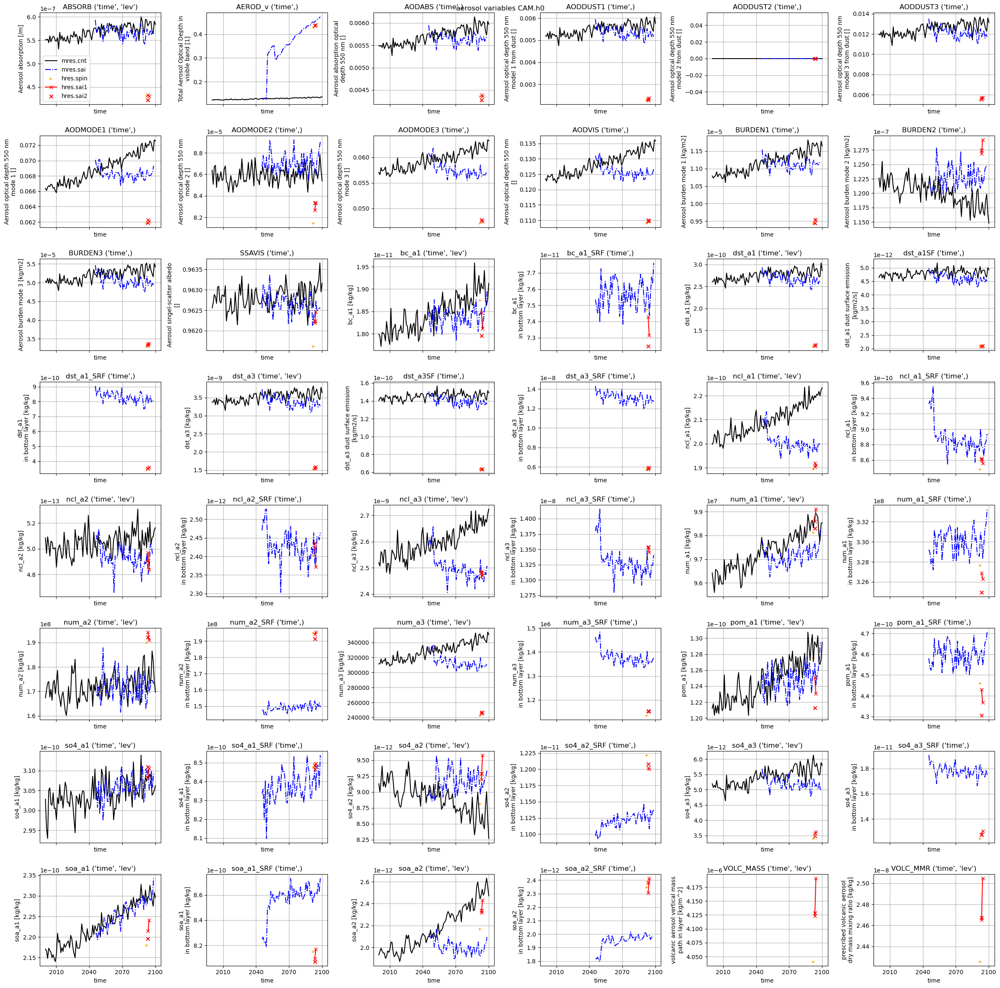

In [10]:
aerosol_vars = ['ABSORB','AEROD_v','AODABS','AODDUST1','AODDUST2','AODDUST3','AODMODE1','AODMODE2','AODMODE3','AODVIS','BURDEN1','BURDEN2','BURDEN3','SSAVIS','bc_a1','bc_a1_SRF', 'dst_a1','dst_a1SF','dst_a1_SRF','dst_a3','dst_a3SF','dst_a3_SRF','ncl_a1','ncl_a1_SRF','ncl_a2','ncl_a2_SRF','ncl_a3','ncl_a3_SRF','num_a1','num_a1_SRF','num_a2','num_a2_SRF','num_a3','num_a3_SRF','pom_a1','pom_a1_SRF','so4_a1','so4_a1_SRF','so4_a2','so4_a2_SRF','so4_a3','so4_a3_SRF','soa_a1','soa_a1_SRF','soa_a2','soa_a2_SRF','VOLC_MASS','VOLC_MMR']
savefig = True
#aerosol_vars = aerosol_vars[:6]; savefig = False # uncomment for quick testing
Nx = 6; Ny = int(np.ceil(len(aerosol_vars)/Nx))
print(len(aerosol_vars), 'aerosol variables')

fig, axs = plt.subplots(Ny,Nx, figsize=(Nx*4,Ny*3), sharex=True)
for i,ax in enumerate(axs.flat[:len(aerosol_vars)]):
    if i!=0:
        plot(ax, aerosol_vars[i])
    else:
        plot(ax, aerosol_vars[i], legendax=ax)
fig.suptitle("aerosol variables CAM.h0")
fig.tight_layout()
if savefig:
    print(f"saving {ODIR+'aerosols.pdf'}")
    fig.savefig(ODIR+'aerosols.pdf')

21 radiation variables
skipping mres cnt FLDSC due to KeyError
saving /Users/jasperdejong/Documents/PhD/Meetings/240828tseries/radiation.pdf


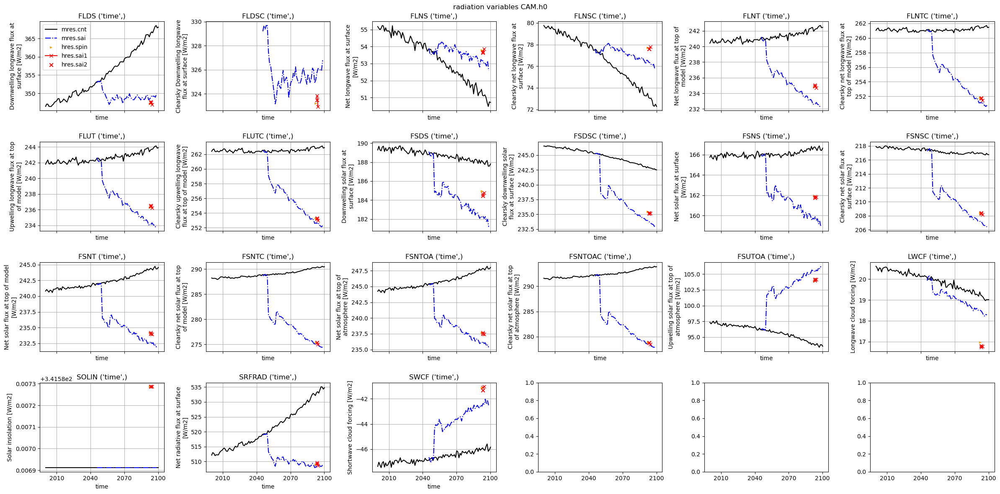

In [11]:
radiation_vars = ['FLDS','FLDSC','FLNS','FLNSC','FLNT','FLNTC','FLUT','FLUTC','FSDS','FSDSC','FSNS','FSNSC','FSNT','FSNTC','FSNTOA','FSNTOAC','FSUTOA','LWCF','SOLIN','SRFRAD','SWCF']
savefig = True
#radiation_vars = radiation_vars[:6]; savefig = False # uncomment for quick testing
Nx = 6; Ny = int(np.ceil(len(radiation_vars)/Nx))
print(len(radiation_vars), 'radiation variables')

fig, axs = plt.subplots(Ny,Nx, figsize=(Nx*4,Ny*3), sharex=True)
for i,ax in enumerate(axs.flat[:len(radiation_vars)]):
    if i!=0:
        plot(ax, radiation_vars[i])
    else:
        plot(ax, radiation_vars[i], legendax=ax)
fig.suptitle("radiation variables CAM.h0")
fig.tight_layout()
if savefig:
    print(f"saving {ODIR+'radiation.pdf'}")
    fig.savefig(ODIR+'radiation.pdf')

249
skipping mres cnt DMS_SRF due to KeyError
skipping mres cnt FLDSC due to KeyError
skipping mres cnt H2O2_SRF due to KeyError
skipping mres cnt H2SO4_SRF due to KeyError
drawing horizontal line for mres cnt P0
drawing horizontal line for mres sai P0
drawing horizontal line for hres sai1 P0
drawing horizontal line for hres sai2 P0
skipping mres cnt PCLDBOT due to KeyError
skipping mres cnt PCLDTOP due to KeyError
skipping mres cnt SO2_SRF due to KeyError
skipping mres cnt SOAG_SRF due to KeyError
skipping mres cnt TAUGWX due to KeyError
skipping mres cnt TAUGWY due to KeyError
skipping mres cnt TREFHTMN due to KeyError
skipping mres cnt TREFHTMX due to KeyError
skipping mres cnt VOLC_MASS due to KeyError
skipping mres sai VOLC_MASS due to KeyError
skipping mres cnt VOLC_MMR due to KeyError
skipping mres sai VOLC_MMR due to KeyError
skipping mres cnt bc_a1_SRF due to KeyError
skipping mres cnt date_written due to dtype |S8
skipping mres sai date_written due to dtype |S8
skipping hres 

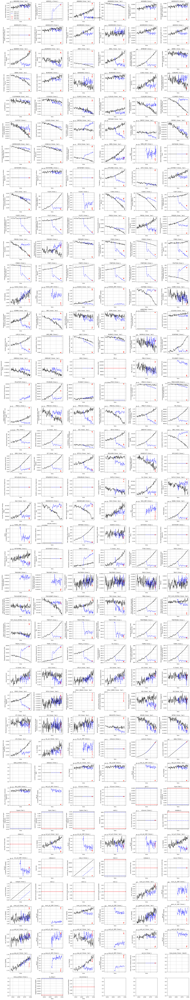

In [12]:
%%time
allvars_plot = allvars
savefig = True
#allvars_plot = allvars_plot[:6]; savefig=False # uncomment for quick test
Nx = 6; Ny = int(np.ceil(len(allvars_plot)/Nx))
print(len(allvars_plot))

fig, axs = plt.subplots(Ny,Nx, figsize=(Nx*4,Ny*3), sharex=True)
for i,ax in enumerate(axs.flat[:len(allvars_plot)]):
    # print(f"\r{i}: {allvars[i]}", end="")
    if i!=0:
        plot(ax, allvars_plot[i])
    else:
        plot(ax, allvars_plot[i], legendax=ax)
fig.suptitle("all variables CAM.h0")
fig.tight_layout()
if savefig:
    print(f"saving {ODIR+'allvar.pdf'}")
    fig.savefig(ODIR+'allvar.pdf')

In [13]:
%%time 
allvars3d_plot = allvars3d
savefig = True
#allvars3d_plot = allvars3d_plot[:2]; savefig=False # uncomment for quick test
Nx = 6; Ny = len(allvars3d_plot)

fig,axs = plt.subplots(Ny,Nx, figsize=(Nx*4,Ny*3), sharey=True)
for i,ax in enumerate(axs):
    if i>0:
        print(i, allvars3d_plot[i])
        plot3d(ax, allvars3d_plot[i])
    else:
        print(i, allvars3d_plot[i])
        plot3d(ax, allvars3d_plot[i], ax[0])
fig.suptitle(r"all 3D variables CAM.h0 (F=2090-2100, I=2000-2010, $\Delta$ w.r.t. all-time mean)")
fig.tight_layout()
if savefig:
    print(f"saving {ODIR+'allvars3d.pdf'}")
    fig.savefig(ODIR+'allvars3d.pdf', dpi=72)

0 ABSORB
1 ANRAIN
2 ANSNOW
3 AQRAIN
4 AQSNOW
5 AREI
6 AREL
7 AWNC
8 AWNI
9 CCN3
10 CLDFSNOW
11 CLDICE
12 CLDLIQ
13 CLOUD
14 CMFDQ
15 CMFDQR
16 CMFDT
17 CMFMC
18 CMFMCDZM
19 CONCLD
20 DCQ
21 DMS
22 DTCOND
23 DTV
24 EXTINCT
25 FICE
26 FREQI
27 FREQL
28 FREQR
29 FREQS
30 H2O2
31 H2SO4
32 ICIMR
33 ICWMR
34 IWC
35 KVH
36 KVM
37 LCLOUD
38 NUMICE
39 NUMLIQ
40 OMEGA
41 OMEGAT
42 Q
43 QC
44 QRL
45 QRS
46 QT
47 QTFLX
48 RELHUM
49 SL
50 SLFLX
51 SLV
52 SO2
53 SOAG
54 T
55 TKE
56 TOT_CLD_VISTAU
57 TOT_ICLD_VISTAU
58 U
59 UFLX
60 US
61 UU
62 V
63 VD01
64 VFLX
65 VOLC_MASS
skipping mres cnt VOLC_MASS due to KeyError
skipping mres sai VOLC_MASS due to KeyError
66 VOLC_MMR
skipping mres cnt VOLC_MMR due to KeyError
skipping mres sai VOLC_MMR due to KeyError
67 VQ
68 VS
69 VT
70 VU
71 VV
72 WSUB
73 WTKE
74 Z3
75 bc_a1
76 dst_a1
77 dst_a3
78 hyai
79 hyam
80 hybi
81 hybm
82 ncl_a1
83 ncl_a2
84 ncl_a3
85 num_a1
86 num_a2
87 num_a3
88 pom_a1
89 so4_a1
90 so4_a2
91 so4_a3
92 soa_a1
93 soa_a2
saving /Users/j